# Импортируем библиотеки

In [36]:
# Импортируем библиотеки

import re
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer

# Загружаем датасеты

In [37]:
# Загружаем датасеты

df_train = pd.read_csv('data/train.csv', low_memory=False) # Train датасет
df_valid = pd.read_csv('data/valid.csv', low_memory=False) # Valid датасет

# Информация о Train датасете

In [38]:
# Характеристика датасета

df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14456 entries, 0 to 14455
Columns: 2666 entries, report_date to col2663
dtypes: float64(2316), int64(3), object(347)
memory usage: 294.0+ MB


In [39]:
# В виде таблицы

df_train.head()

,report_date,client_id,target,col1,col2,col3,col4,col5,col6,col7,...,col2654,col2655,col2656,col2657,col2658,col2659,col2660,col2661,col2662,col2663
0,2022-11-01,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.256261
1,2022-11-01,5,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,7616803.0,7616803.0,7616803.0,NaN,NaN,NaN,7616803.0,7616803.0,7616803.0,0.256261
2,2022-05-01,6,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.256261
3,2022-09-01,7,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.258682
4,2022-08-01,8,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.254164


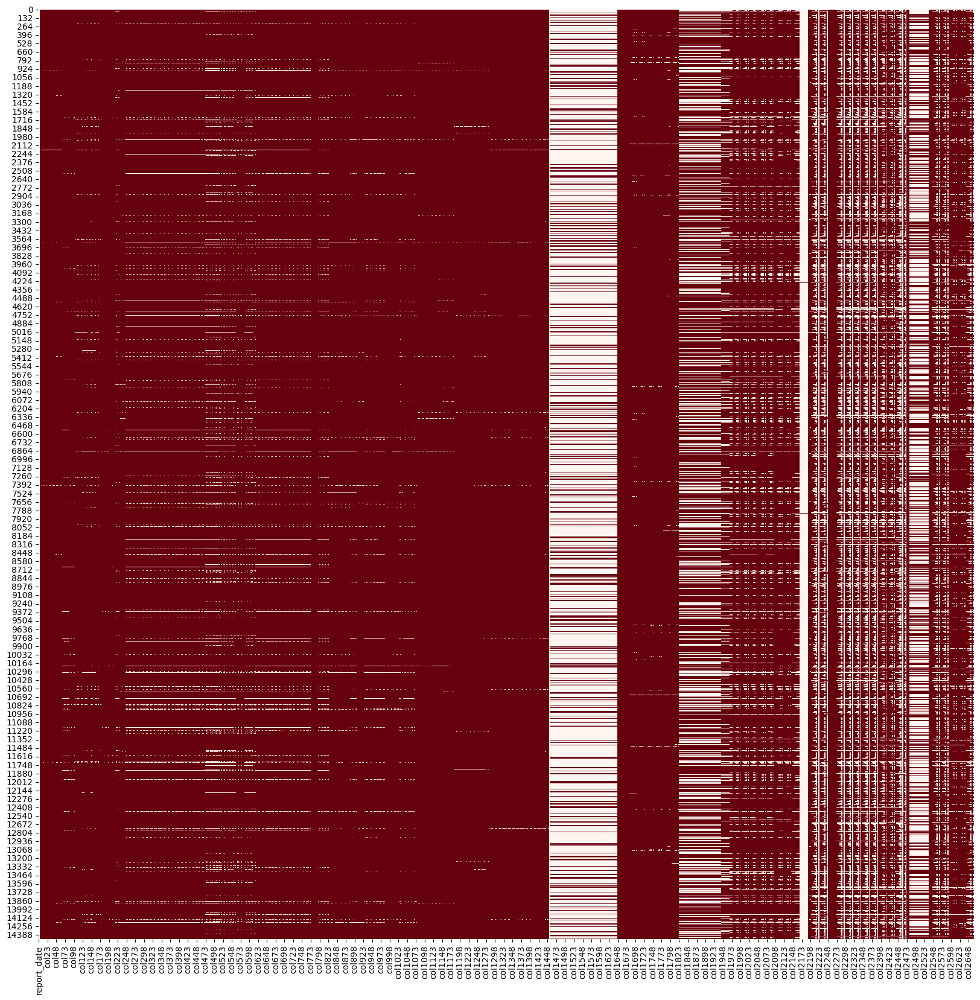

In [40]:
# Хитмапа датасета

plt.figure(figsize=(20, 20))
sb.heatmap(df_train.isnull(), cbar=False, cmap='Reds')
plt.show()

# Обрабатываем датасет

In [41]:
# Отбрасываем колонки в которых нет 50 % информации
df_train_processed = df_train.loc[:, df_train.notnull().mean() >= 0.5]

# Отбрасываем лишние колонки
df_train_processed = df_train_processed.drop(columns=['report_date', 'col1454'])

# Заполняем пропуски
df_train_processed = pd.DataFrame(
         SimpleImputer(missing_values=np.nan, strategy='most_frequent').fit_transform(df_train_processed), 
         columns=df_train_processed.columns)

# # Заполнение пропусков с помощью IterativeImputer НЕ РАБОТАЕТ
# from sklearn.tree import DecisionTreeRegressor
# X = df_train_processed.copy(deep = True) #создаем копию датасета
# myImputer=IterativeImputer(estimator=DecisionTreeRegressor(), max_iter=10, random_state=0)
# myImputer.fit(X)
# myImputer_data = myImputer.transform(X)
# df_train_processed = pd.DataFrame(myImputer_data,columns = df_train_processed.columns)

# Чиним заголовки
df_train_processed = df_train_processed.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

# Сортируем по client_id
# df_train_processed = df_train_processed.sort_values('client_id')

# Баланс классов

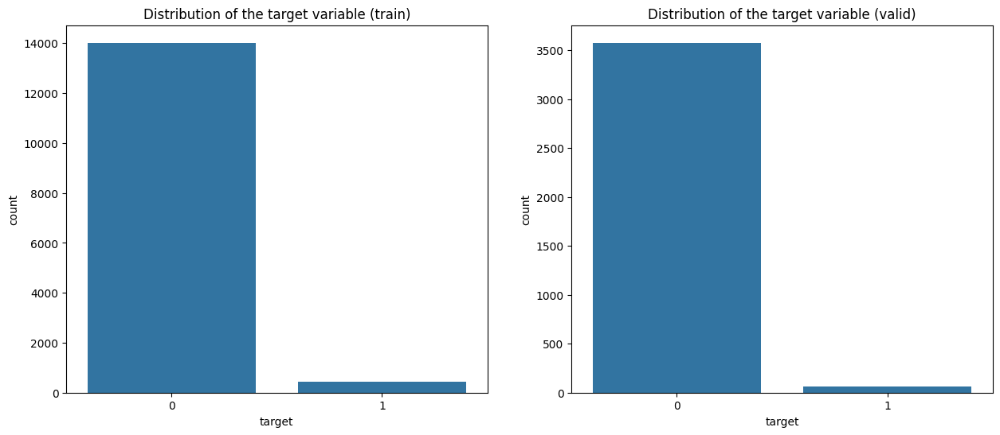

In [42]:
# Смотрим баланс классов


target_distribution_train = df_train['target'].value_counts()
target_distribution_val = df_valid['target'].value_counts()
fig, axs = plt.subplots(1, 2, figsize=(15, 6))

# train датасет
sb.countplot(x='target', data=df_train, ax=axs[0])  #
axs[0].set_title('Distribution of the target variable (train)')

# valid датасет
sb.countplot(x='target', data=df_valid, ax=axs[1])  
axs[1].set_title('Distribution of the target variable (valid)')

plt.show()

# Конечный результат

In [43]:
# Характеристика датасета

df_train_processed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14456 entries, 0 to 14455
Columns: 341 entries, client_id to col2663
dtypes: float64(341)
memory usage: 37.6 MB


In [44]:
# В виде таблицы

df_train_processed.head()

,client_id,target,col1453,col1455,col1456,col1457,col1458,col1459,col1460,col1461,...,col2564,col2565,col2566,col2588,col2589,col2590,col2660,col2661,col2662,col2663
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,3000000.0,3000000.0,3000000.0,240.0,240.0,240.0,3000000.0,3000000.0,3000000.0,0.256261
1,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,5903704.0,5903704.0,5903704.0,362.0,362.0,362.0,7616803.0,7616803.0,7616803.0,0.256261
2,6.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,...,3000000.0,3000000.0,3000000.0,240.0,240.0,240.0,3000000.0,3000000.0,3000000.0,0.256261
3,7.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,3000000.0,3000000.0,3000000.0,240.0,240.0,240.0,3000000.0,3000000.0,3000000.0,0.258682
4,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,...,3000000.0,3000000.0,3000000.0,240.0,240.0,240.0,3000000.0,3000000.0,3000000.0,0.254164


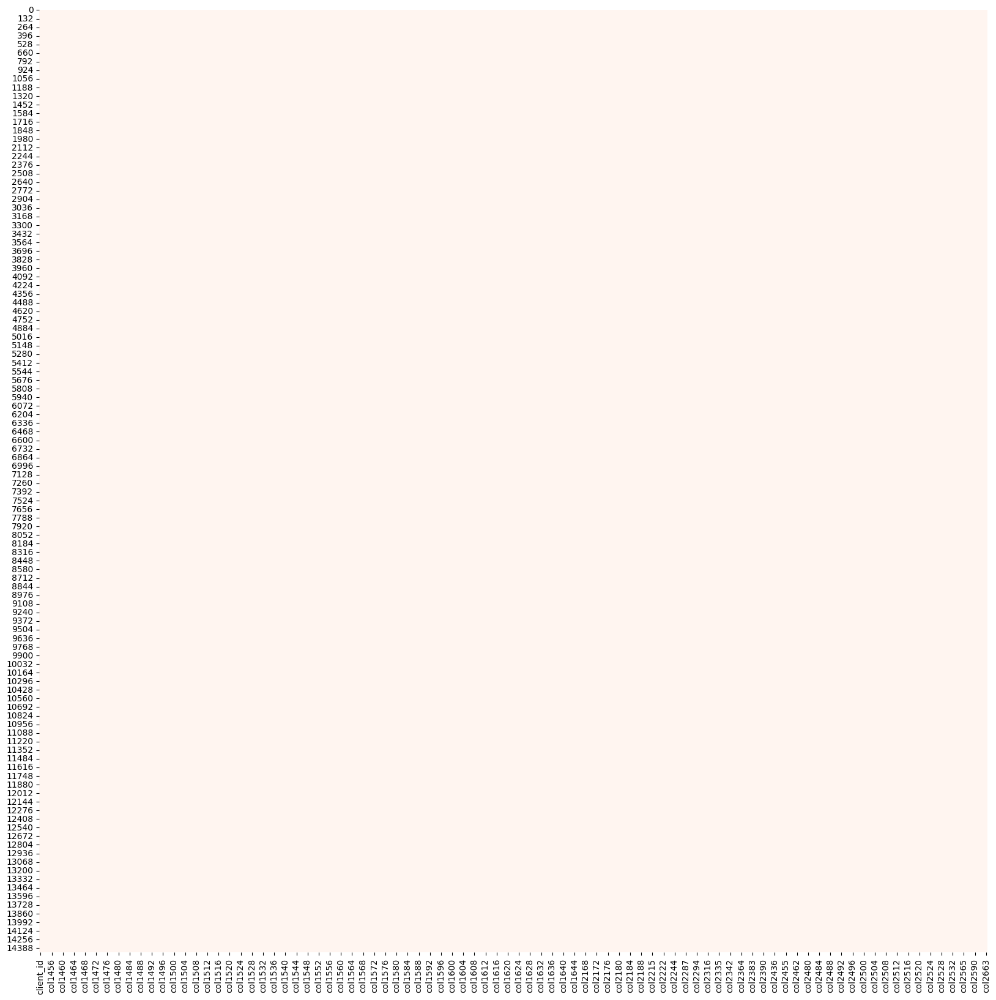

In [45]:
# Хитмапа датасета

plt.figure(figsize=(20, 20))
sb.heatmap(df_train_processed.isnull(), cbar=False, cmap='Reds')
plt.show()

In [46]:
print(df_train_processed.to_string())

       client_id  target  col1453  col1455  col1456  col1457  col1458  col1459  col1460  col1461  col1462  col1463  col1464  col1465  col1466  col1467  col1468  col1469  col1470  col1471  col1472  col1473  col1474  col1475  col1476  col1477  col1478  col1479  col1480  col1481  col1482  col1483  col1484  col1485  col1486  col1487  col1488  col1489  col1490  col1491  col1492  col1493  col1494  col1495  col1496  col1497  col1498  col1499  col1500  col1501  col1502  col1503  col1504  col1505  col1506  col1507  col1508  col1509  col1510  col1511  col1512  col1513  col1514  col1515  col1516  col1517  col1518  col1519  col1520  col1521  col1522  col1523  col1524  col1525  col1526  col1527  col1528  col1529  col1530  col1531  col1532  col1533  col1534  col1535  col1536  col1537  col1538  col1539  col1540  col1541  col1542  col1543  col1544  col1545  col1546  col1547  col1548  col1549  col1550  col1551  col1552  col1553  col1554  col1555  col1556  col1557  col1558  col1559  col1560  col1561  co

# Приводим valid датасет к train датасету

In [47]:
# Приводим valid датасет к train

train_columns = df_train_processed.columns 
df_valid_processed = df_valid[train_columns]

print(f'{df_train_processed.shape}\n{df_valid_processed.shape}')

(14456, 341)
(3642, 341)


# Сохраняем датасеты

In [48]:
df_train_processed.to_csv('data/train_processed.csv')
df_valid_processed.to_csv('data/valid_processed.csv')